In [ ]:
!pip install torchvision

In [ ]:
!apt install pv
!pv drive/MyDrive/DLIM/reshaped_data.tar.gz > data.tar.gz
!tar xvf data.tar.gz

In [ ]:
import torch
import torch.nn as nn
import numpy as np
import glob
import os
import random
import tqdm
import sys
import pandas as pd

import PIL
import PIL.Image

import cv2 as cv

import matplotlib.pyplot as plt

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import save_image
import torchvision.transforms.functional as tf

from skimage.morphology import thin, area_opening, erosion, dilation, square, disk, remove_small_objects

## Dataset and DataLoader

Split dataset into Train / Validation / Test set

In [ ]:
# Split data between Train / Val / Test
def split_train_val_test(files_path, test_size=0.1):
    '''
    Split the list containing the files path into a train / val / test sets.
    Split for one author.

    Parameters:
    ----------
    files_path : Python List holding path of the images
    test_size : Size of the test set (10% by default)
    
    Returns:
    ----------
    Tuple
        with 3 elements: Train List / Val List / Test List
    '''
    nb_files = len(files_path)
    ids = np.arange(nb_files)
    np.random.shuffle(ids)

    split_test = int(test_size * nb_files)
    split_val = 2 * split_test

    return files_path[split_val:], \
           files_path[split_test:split_val], \
           files_path[:split_test]

def get_data_paths(folder_path):
    '''
    Get paths (Train / Val / Test) of the data.
    The split is made by author.
    For each author some samples are used in the train / val and test set.

    Parameters:
    ----------
    folder_path: Folder dataset path

    Returns:
    ----------
    Tuple
        with 3 elements: Train List / Val List / Test List
    '''
    folders = glob.glob(os.path.join(folder_path, '*'))

    tr, val, te = [], [], []

    for f_path in folders:

        files_path = glob.glob(os.path.join(f_path, '*'))
        files_train, files_val, files_test = split_train_val_test(files_path)

        tr.extend(files_train)
        val.extend(files_val)
        te.extend(files_test)

    return tr, val, te

Class for the dataset (holding information of the files paths)

In [ ]:
class PrintDataset(Dataset):
    def __init__(self, data_path):
        '''
        Parameters:
        ----------
        data_path: Python List holding the data path
        '''
        self.data_path = data_path

    def __len__(self):
        return len(self.data_path)

    def __getitem__(self, idx):
        '''
        Parameters:
        ----------
        idx: Index of the item we want to get in [0, len(self.data_path)-1]
        '''
        # Read data from disk and convert to numpy array
        img_pil = PIL.Image.open(self.data_path[idx])
        img_np = np.array(img_pil)

        # Convert input data to grayscale and uint8
        img_gray = 0.2989 * img_np[:, :, 0] + 0.5870 * img_np[:, :, 1] + 0.1140 * img_np[:, :, 2]
        img_gray = img_gray.astype(np.uint8)

        # Get edges using Canny edges detector
        edges = cv.Canny(img_gray, 150, 220)

        # Get input and target (in torch tensor)
        # Apply a threshold to keep only relevant/main information
        input = torch.from_numpy((edges > 125).astype(float))
        target = torch.from_numpy(img_np)

        # Get the transformation object (for normalization)
        transform = transforms.Compose([
                           transforms.ConvertImageDtype(torch.float),
                           transforms.Normalize(mean=0.5,
                                                std=0.5)
                       ])

        # Stack the input to get a 3 channel image (Still grayscale)
        input = torch.stack([input, input, input], dim=0)
        target = torch.permute(target, (2, 0, 1))

        # Apply transformation on input and on target image
        input = transform(input)
        target = transform(target)

        # Apply random horizontal flip
        # Using torchvision functionnal
        if random.random() > 0.5:
            input = tf.hflip(input)
            target = tf.hflip(target)

        return input, target

### Display some images from the train set

In [ ]:
train_path, val_path, test_path = get_data_paths('reshaped_data/')
len(train_path), len(val_path), len(test_path)

(12875, 1592, 1592)

In [ ]:
train_dataset = PrintDataset(train_path)
input, target = train_dataset[0]
input.shape, target.shape

(torch.Size([3, 256, 256]), torch.Size([3, 256, 256]))

(256, 256, 3) (256, 256, 3)


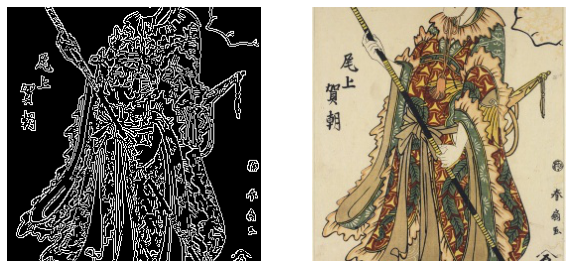

In [ ]:
input = torch.permute(input, (1, 2, 0))
input_np = input.cpu().detach().numpy()

target = torch.permute(target, (1, 2, 0))
target_np = target.cpu().detach().numpy()

print(input_np.shape, target_np.shape)


plt.figure(figsize=(10, 12))

plt.subplot(1, 2, 1)
plt.axis('off')
plt.imshow(input_np * 0.5 + 0.5, cmap='gray')


plt.subplot(1, 2, 2)
plt.axis('off')
plt.imshow(target_np * 0.5 + 0.5)

plt.show()

## Utils functions

Some utils function to save / load the models

In [ ]:
def save_some_examples(model, val_dataloader, epoch, folder, device):
    '''
    Save some samples after one epoch

    Parameters:
    ----------
    model: Pytorch model (Generator)
    val_dataloader: Dataloader for validation
    epoch: Epoch number (Keep track of the generation at a specific epoch)
    folder: Folder to save the results
    device: Device on which to run the model (torch.device('cuda') / torch.device('cpu'))
    '''
    # Get sample from the dataloader
    x, y = next(iter(val_dataloader))
    x, y = x.to(device), y.to(device)

    # Save the ground truth only for the first epoch
    if epoch == 1:
        path_ref = os.path.join(folder, 'label.png')
        save_image(y * 0.5 + 0.5, path_ref)

    # Put the model in evaluation mode
    model.eval()

    # Save path (for the input and the generator)
    path_gen = os.path.join(folder, 'y_gen_{}.png'.format(epoch))
    path_input = os.path.join(folder, 'input_{}.png'.format(epoch))

    with torch.no_grad():
        y_fake = model(x)

    # Save images and remove the normalization
    save_image(y_fake * 0.5 + 0.5, path_gen)
    save_image(x * 0.5 + 0.5, path_input)

def save_checkpoint(model, optimizer, filename="model_checkpoint.pth.tar"):
    '''
    Save the model and the optimizer
    Can be wether for Generator of Discriminator

    Parameters:
    ----------
    model: Pytorch model
    optimizer: Pytorch optimizer
    filename: Path to save the model
    '''
    print("=> Saving checkpoint")
    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict(),
    }
    torch.save(checkpoint, filename)

def load_checkpoint(path, model, optimizer, lr, device):
    '''
    Load checkpoint

    Parameters:
    ----------
    path: Path to the checkpoint
    model: Pytorch model (load the checkpoint parameters in the model)
    optimizer: Pytorch optimizer
    lr: Learning rate (set the proper learning rate in the optimizer)
    device: Device on which to load the model
    '''
    print("=> Loading checkpoint")
    checkpoint = torch.load(path, map_location=device)
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])

    # If we don't do this then it will just have learning rate of old checkpoint
    # and it will lead to many hours of debugging
    for param_group in optimizer.param_groups:
        param_group["lr"] = lr

def load_checkpoint_test(path, model, device):
    '''
    Load model checkpoint for the test case

    Parameters:
    ----------
    path: Path to the model checkpoint
    model: Pytorch model (Load the learning parameters)
    device: Device on which to load the model
    '''
    checkpoint = torch.load(path, map_location=device)
    model.load_state_dict(checkpoint["state_dict"])

def create_folder_if_not_exist(folder):
    '''
    Create a folder if it does not exist

    Parameters:
    ----------
    folder: Folder to create
    '''
    if not os.path.exists(folder):
        os.makedirs(folder)

## Pix2Pix Model

Implementation is made according to the paper but the image input shape is different. We used 256x256 input shape images to train our model instead of 286x286.

### Discriminator

In [ ]:
class CNNBlock(nn.Module):
    '''
    Convolution Block.
    According to the paper: Conv2D -> BatchNorm2D -> LeakyReLU
    '''
    def __init__(self, in_channels, out_channels, stride=2):
        super().__init__()

        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 4, stride, bias=False, padding_mode='reflect'),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2)
        )

    def forward(self, x):
        return self.conv(x)

# Input of the discriminator is RGB image
# Input: 256x256 -> 30x30
# For the discriminator we also used the target image according to the paper
class Discriminator(nn.Module):
    '''
    Discriminator model.
    This model has to determine if the input image is a fake one of a real one.
    For the initial Conv they don't use BatchNorm2D.
    '''
    def __init__(self, in_channels=3, features=[64, 128, 256, 512]):
        super().__init__()

        # For the first block they don't use batch norm
        self.initial_block = nn.Sequential(
            nn.Conv2d(in_channels * 2, features[0], kernel_size=4, stride=2, padding=1, padding_mode="reflect"),
            nn.LeakyReLU(0.2)
        )

        layers = []
        in_channels = features[0]
        for feature in features[1:]:
            nb_stride = 1 if feature == features[-1] else 2
            layers.append(CNNBlock(in_channels, feature, stride=nb_stride))

            in_channels = feature

        # output layer
        layers.append(
            nn.Conv2d(in_channels, 1, kernel_size=4, stride=1, padding=1, padding_mode='reflect'),
        )

        self.model = nn.Sequential(*layers)

    # y fake or real
    def forward(self, x, y):
        x = torch.cat([x, y], dim=1)
        x = self.initial_block(x)
        return self.model(x)

Let's make a little test to check if the shape is correct

In [ ]:
# TEST
# In our dataset (256, 256) -> in the paper input shape 286x286
# Input shape=(batch_size, nb_channels, img_height, img_width)
# Target shape=(batch_size, nb_channels, img_height, img_width)
x = torch.randn((1, 3, 256, 256))
y = torch.randn((1, 3, 256, 256))
model = Discriminator()
pred = model(x, y)
pred.shape

torch.Size([1, 1, 26, 26])

In [ ]:
# Generator model
class UNetBlock(nn.Module):
    '''
    One Conv block for UNet model (wether downsampling and upsampling)
    Upsampling is done using Conv 2D Transpose
    '''
    def __init__(self, in_channels, out_channels, down=True, act='relu', use_dropout=False):
        super().__init__()

        layers = []

        if down:
            layers.append(nn.Conv2d(in_channels, out_channels, 4, 2, 1, bias=False, padding_mode='reflect'))
        else:
            layers.append(nn.ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False))

        layers.append(nn.BatchNorm2d(out_channels))
        layers.append(nn.ReLU() if act == 'relu' else nn.LeakyReLU(0.2))

        if use_dropout:
            layers.append(nn.Dropout(0.5))

        self.layers_pred = nn.Sequential(*layers)

    def forward(self, x):
        return self.layers_pred(x)

class Generator(nn.Module):
    '''
    Generator model with UNet blocks (Encoder / Decoder)
    '''
    def __init__(self, in_channels=3, features=64):
        super().__init__()

        # Encoder
        self.initial_down = nn.Sequential(
            nn.Conv2d(in_channels, features, 4, 2, 1, padding_mode='reflect'),
            nn.LeakyReLU(0.2),
        ) # 128

        self.down1 = UNetBlock(features, 2*features, down=True, act='leaky', use_dropout=False) # 64
        self.down2 = UNetBlock(2*features, 4*features, down=True, act='leaky', use_dropout=False) # 32
        self.down3 = UNetBlock(4*features, 8*features, down=True, act='leaky', use_dropout=False) # 16
        self.down4 = UNetBlock(8*features, 8*features, down=True, act='leaky', use_dropout=False) # 8
        self.down5 = UNetBlock(8*features, 8*features, down=True, act='leaky', use_dropout=False) # 4
        self.down6 = UNetBlock(8*features, 8*features, down=True, act='leaky', use_dropout=False) # 2

        # BottleNeck
        self.bottleneck = nn.Sequential(
            nn.Conv2d(8*features, 8*features, 4, 2, 1, padding_mode='reflect'),  # 1
            nn.ReLU()
        )

        # Decoder
        # Twice more input channels because we use residual learning
        self.up1 = UNetBlock(8*features, 8*features, down=False, act='relu', use_dropout=True)
        self.up2 = UNetBlock(16*features, 8*features, down=False, act='relu', use_dropout=True)
        self.up3 = UNetBlock(16*features, 8*features, down=False, act='relu', use_dropout=True)
        self.up4 = UNetBlock(16*features, 8*features, down=False, act='relu', use_dropout=True)
        self.up5 = UNetBlock(16*features, 4*features, down=False, act='relu', use_dropout=True)
        self.up6 = UNetBlock(8*features, 2*features, down=False, act='relu', use_dropout=True)
        self.up7 = UNetBlock(4*features, features, down=False, act='relu', use_dropout=True)

        self.final_layer = nn.Sequential(
            nn.ConvTranspose2d(2*features, in_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh(),
        )

    def forward(self, x):
        # Encoder
        d1 = self.initial_down(x)
        d2 = self.down1(d1)
        d3 = self.down2(d2)
        d4 = self.down3(d3)
        d5 = self.down4(d4)
        d6 = self.down5(d5)
        d7 = self.down6(d6)

        # Bottleneck
        bottleneck = self.bottleneck(d7)

        # Decoder
        up1 = self.up1(bottleneck)
        up2 = self.up2(torch.cat([up1, d7], dim=1))
        up3 = self.up3(torch.cat([up2, d6], dim=1))
        up4 = self.up4(torch.cat([up3, d5], dim=1))
        up5 = self.up5(torch.cat([up4, d4], dim=1))
        up6 = self.up6(torch.cat([up5, d3], dim=1))
        up7 = self.up7(torch.cat([up6, d2], dim=1))

        # Final layer
        return self.final_layer(torch.cat([up7, d1], dim=1))

In [ ]:
# TODO maybe better
# if you replace
#         nn.BatchNorm2d(out_channels),
# with
#         nn.InstanceNorm2d(out_channels, affine=True),
# in both Discriminator and Generator blocks the artifacts are disappear. Also you'll get better results.
#         The authors have already replaced BatchNorm with InstanceNorm in the CycleGAN paper.

In [ ]:
# TEST case
x = torch.randn((1, 3, 256, 256))
model = Generator(in_channels=3, features=64)
preds = model(x)
preds.shape

torch.Size([1, 3, 256, 256])

## Train model

Training functions and evaluating functions

Get the device

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [ ]:
def train(models, dataloader, optimizers, losses, grad_scalers, l1_lambda):
    discr, gen = models
    optimizer_discr, optimizer_gen = optimizers
    bce_loss_fn, l1_loss_fn = losses
    g_scaler, d_scaler = grad_scalers

    # Store losses
    g_losses, d_losses = [], []

    # Put models in train mode
    discr.train()
    gen.train()

    loop = tqdm.tqdm(dataloader, desc='training...', file=sys.stdout, position=0, leave=True)

    for idx, (input, target) in enumerate(loop):
        input = input.to(device)
        target = target.to(device)

        # Train Discriminator
        # Generate fake image (with generator)
        # Launch discriminator on both images (Real one and generated one)
        # The discriminator takes also the input as input 
        with torch.cuda.amp.autocast():
            gen_fake = gen(input)
            pred_fake = discr(input, gen_fake.detach())
            pred_real = discr(input, target)

            # Compute loss
            d_fake_loss = bce_loss_fn(pred_fake, torch.zeros_like(pred_fake))
            d_real_loss = bce_loss_fn(pred_real, torch.ones_like(pred_real))
            d_loss = (d_fake_loss + d_real_loss) / 2

            d_losses.append(d_loss)

        # Back propagation
        optimizer_discr.zero_grad()
        d_scaler.scale(d_loss).backward()
        d_scaler.step(optimizer_discr)
        d_scaler.update()

        # Train Generator
        # Apply discriminator on fake data
        # Compute loss for Generator
        with torch.cuda.amp.autocast():
            pred_fake = discr(input, gen_fake)

            # Compute loss
            g_fake_loss = bce_loss_fn(pred_fake, torch.ones_like(pred_fake))
            l1 = l1_loss_fn(gen_fake, target)
            g_loss = g_fake_loss + l1_lambda * l1

            g_losses.append(g_loss)

        # Back propagation
        optimizer_gen.zero_grad()
        g_scaler.scale(g_loss).backward()
        g_scaler.step(optimizer_gen)
        g_scaler.update()

    return torch.tensor(d_losses).mean(), torch.tensor(g_losses).mean()

def evaluate(models, dataloader, losses):
    discr, gen = models
    bce_loss_fn, l1_loss_fn = losses

    # Store losses
    g_losses, d_losses = [], []

    discr.eval()
    gen.eval()

    with torch.no_grad():
        loop = tqdm.tqdm(dataloader, desc='evaluting...', file=sys.stdout, position=0, leave=True)
        for idx, (input, target) in enumerate(loop):
            input = input.to(device)
            target = target.to(device)

            # Generate fake data
            gen_fake = gen(input)

            # Check if discriminator can make the difference
            pred_fake = discr(input, gen_fake.detach())
            pred_real = discr(input, target)

            # Compute loss for the discriminator
            d_fake_loss = bce_loss_fn(pred_fake, torch.zeros_like(pred_fake))
            d_real_loss = bce_loss_fn(pred_real, torch.ones_like(pred_real))
            d_loss = (d_fake_loss + d_real_loss) / 2

            # Check if discriminator can make the difference
            # With no detech
            # So we can backpropagate the loss for the generated image
            pred_fake = discr(input, gen_fake)

            # Compute loss for generator
            # Make the generator label as 1
            # So if the discriminator made an error (This image is real whereas it's fake)
            # -> The Generator backpropagate lower loss
            g_fake_loss = bce_loss_fn(pred_fake, torch.ones_like(pred_fake))
            l1 = l1_loss_fn(gen_fake, target)
            g_loss = g_fake_loss + l1_lambda * l1

            d_losses.append(d_loss)
            g_losses.append(g_loss)

    return torch.tensor(d_losses).mean(), torch.tensor(g_losses).mean()

def train_epochs(dataloaders, n_epochs, lr, l1_lambda, device, path_checkpoints, save_img_folders, load_model=False, save_model=True):
    save_img_folder_train, save_img_folder_eval = save_img_folders

    create_folder_if_not_exist(save_img_folder_train)
    create_folder_if_not_exist(save_img_folder_eval)

    train_dataloader, val_dataloader = dataloaders
    checkpoint_gen, checkpoint_discr = path_checkpoints

    # Get models
    discr = Discriminator(in_channels=3).to(device)
    gen = Generator(in_channels=3).to(device)

    # Get optimizers
    optimizer_discr = torch.optim.Adam(discr.parameters(), lr=lr[1], betas=(0.5, 0.999))
    optimizer_gen = torch.optim.Adam(gen.parameters(), lr=lr[0], betas=(0.5, 0.999))

    # Load model if necessary
    if load_model:
        load_checkpoint(checkpoint_gen, gen, optimizer_gen, lr)
        load_checkpoint(checkpoint_discr, discr, optimizer_discr, lr)

    # Get Loss
    bce_loss = nn.BCEWithLogitsLoss()
    l1_loss = nn.L1Loss()

    # Get gradient scalers
    g_scaler = torch.cuda.amp.GradScaler()
    d_scaler = torch.cuda.amp.GradScaler()

    # Train multiple epochs
    for epoch in range(n_epochs):
        print("----- Epoch {} -----".format(epoch))
        train_d_loss, train_g_loss = train((discr, gen),
                                            train_dataloader,
                                            (optimizer_discr, optimizer_gen),
                                            (bce_loss, l1_loss),
                                            (g_scaler, d_scaler),
                                            l1_lambda)

        eval_d_loss, eval_g_loss = evaluate((discr, gen),
                                             val_dataloader,
                                             (bce_loss, l1_loss))

        print()
        print("TRAIN")
        print("Discr Loss: {}".format(train_d_loss))
        print("Gen Loss:   {}".format(train_g_loss))
        print()
        print("EVAL")
        print("Discr Loss: {}".format(eval_d_loss))
        print("Gen Loss:   {}".format(eval_g_loss))
        print("------------------------")

        if save_model and epoch % 5 == 0:
            save_checkpoint(gen, optimizer_gen, checkpoint_gen)
            save_checkpoint(discr, optimizer_discr, checkpoint_discr)

        save_some_examples(gen, train_dataloader, epoch, save_img_folder_train, device)
        save_some_examples(gen, val_dataloader, epoch, save_img_folder_eval, device)

Split the dataset between Train / Val / Test and get the path.

To avoid using validation or test data for the training when loading the model (no need to recompute the lists from scratch)

If the model has already been trained, path for train / val / test can be loaded.

In [ ]:
# Get TRAIN / VAL / TEST

# train_path, val_path, test_path = get_data_paths('reshaped_data/')

path_save = 'drive/MyDrive/DLIM/'
# df_paths_train = pd.DataFrame({'train': train_path})
# df_paths_val_test = pd.DataFrame({'val': val_path, 'test': test_path})

# df_paths_train.to_csv(path_save + 'train_split.csv')
# df_paths_val_test.to_csv(path_save + 'val_test_split.csv')

# -------------------------

# Load TRAIN / VAL / TEST

train_path = pd.read_csv(path_save + 'train_split.csv')['train'].tolist()

df_val_test = pd.read_csv(path_save + 'val_test_split.csv')
val_path = df_val_test['val'].tolist()
test_path = df_val_test['test'].tolist()

len(train_path), len(val_path), len(test_path)

(12875, 1592, 1592)

Build the dataloaders with a batch size of 4 and a l1 lambda of 100

In [ ]:
batch_size = 4
num_workers = 4
l1_lambda = 100

# Get datasets
train_dataset = PrintDataset(train_path)
val_dataset = PrintDataset(val_path)
test_dataset = PrintDataset(test_path)

# Get dataloader
train_dataloader = DataLoader(train_dataset,
                              batch_size=batch_size,
                              shuffle=True,
                              num_workers=num_workers)

val_dataloader = DataLoader(val_dataset,
                            batch_size=batch_size,
                            shuffle=True,
                            num_workers=num_workers)

test_dataloader = DataLoader(test_dataset,
                             batch_size=batch_size,
                             num_workers=num_workers)

In [ ]:
len(train_dataloader), len(val_dataloader), len(test_dataloader)

(3219, 398, 398)

Train model with a low learning rate for the discriminator

In [ ]:
CHECKPOINT_DISC = "drive/MyDrive/DLIM/models/disc.pth.tar"
CHECKPOINT_GEN = "drive/MyDrive/DLIM/models/gen.pth.tar"

In [ ]:
lr_gen = 1e-4
lr_discr = 7e-5
n_epochs = 30

gen_path = "drive/MyDrive/DLIM/gen_img/"
gen_path_train = gen_path + "gen_train"
gen_path_eval = gen_path + "gen_eval"

train_epochs((train_dataloader, val_dataloader),
             n_epochs, (lr_gen, lr_discr), l1_lambda, device,
             (CHECKPOINT_GEN, CHECKPOINT_DISC),
             (gen_path_train, gen_path_eval))

----- Epoch 0 -----
evaluting...: 100%|██████████| 398/398 [00:12<00:00, 31.39it/s]

TRAIN
Discr Loss: 0.19123154878616333
Gen Loss:   36.615482330322266

EVAL
Discr Loss: 0.9745476245880127
Gen Loss:   33.58024215698242
------------------------
=> Saving checkpoint
=> Saving checkpoint
----- Epoch 1 -----
evaluting...: 100%|██████████| 398/398 [00:12<00:00, 31.42it/s]

TRAIN
Discr Loss: 0.11843402683734894
Gen Loss:   36.54557800292969

EVAL
Discr Loss: 1.2899789810180664
Gen Loss:   34.67951202392578
------------------------
----- Epoch 2 -----
evaluting...: 100%|██████████| 398/398 [00:12<00:00, 31.35it/s]

TRAIN
Discr Loss: 0.12881150841712952
Gen Loss:   36.49919128417969

EVAL
Discr Loss: 0.9955720901489258
Gen Loss:   31.209524154663086
------------------------
----- Epoch 3 -----
evaluting...: 100%|██████████| 398/398 [00:12<00:00, 30.77it/s]

TRAIN
Discr Loss: 0.10111969709396362
Gen Loss:   36.895572662353516

EVAL
Discr Loss: 2.0362799167633057
Gen Loss:   32.96133804321289


KeyboardInterrupt: ignored

Load pretrained model

In [ ]:
lr_gen = 1e-4
lr_discr = 7e-5

# Get models
discr = Discriminator(in_channels=3).to(device)
gen = Generator(in_channels=3).to(device)

# Get optimizers
optimizer_discr = torch.optim.Adam(discr.parameters(), lr=lr_discr, betas=(0.5, 0.999))
optimizer_gen = torch.optim.Adam(gen.parameters(), lr=lr_gen, betas=(0.5, 0.999))

# Load the parameters
load_checkpoint(CHECKPOINT_GEN, gen, optimizer_gen, lr_gen, device)
load_checkpoint(CHECKPOINT_DISC, discr, optimizer_discr, lr_discr, device)

=> Loading checkpoint
=> Loading checkpoint


## Test the model

In [ ]:
def display_imgs(input, pred, target):
    plt.figure(figsize=(12, 10))

    plt.subplot(1, 3, 1)
    plt.axis('off')
    plt.imshow(input)

    plt.subplot(1, 3, 2)
    plt.axis('off')
    plt.imshow(pred)

    plt.subplot(1, 3, 3)
    plt.axis('off')
    plt.imshow(target)

    plt.show()


def test_model(dataloader, gen):
    gen.eval()

    for idx, (input, target) in enumerate(dataloader):
        with torch.no_grad():
            input = input.to(device)
            pred = gen(input)

            # Remove normalization
            input = input * 0.5 + 0.5
            target = target * 0.5 + 0.5
            pred = pred * 0.5 + 0.5

            input = torch.permute(input, (0, 2, 3, 1))
            target = torch.permute(target, (0, 2, 3, 1))
            pred = torch.permute(pred, (0, 2, 3, 1))

            for i in range(input.shape[0]):
                display_imgs(input[i].detach().cpu().numpy(), pred[i].detach().cpu().numpy(), target[i].detach().cpu().numpy())

        if idx == 10:
            break

Check the results on the train / validation / test set

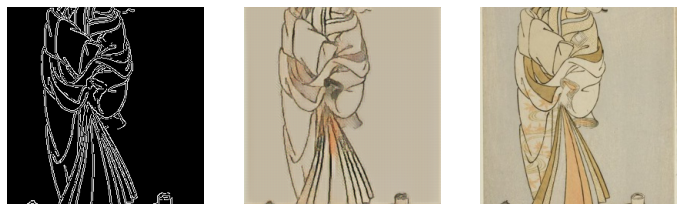

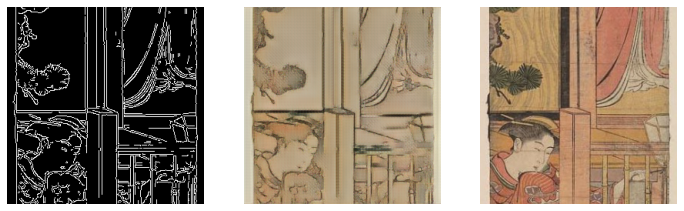

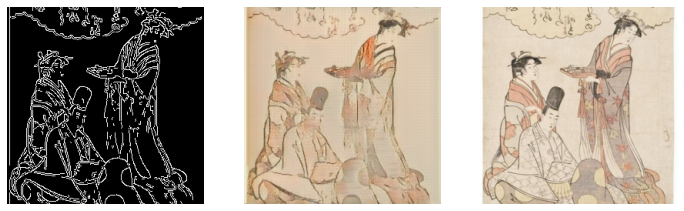

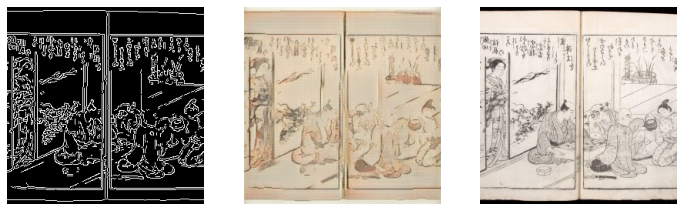

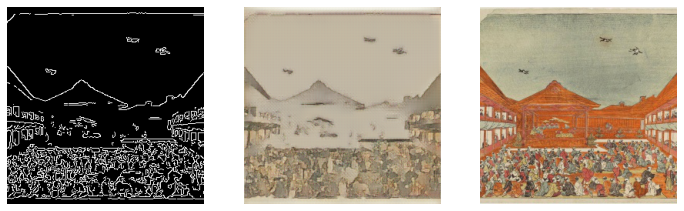

...

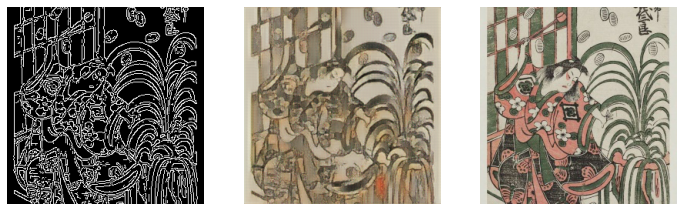

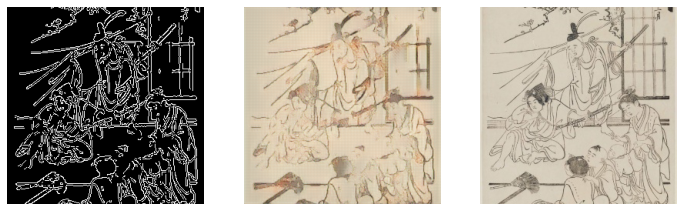

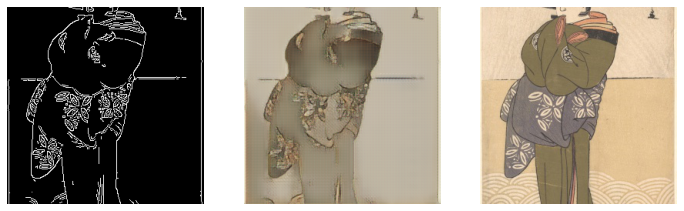

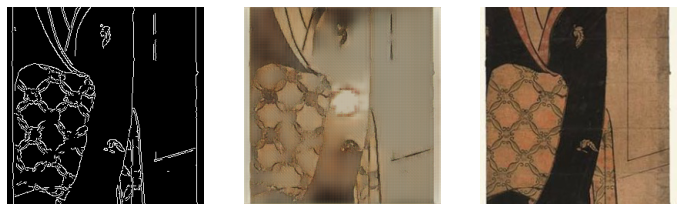

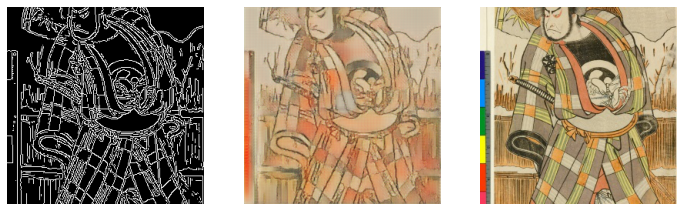

In [ ]:
test_model(train_dataloader, gen)

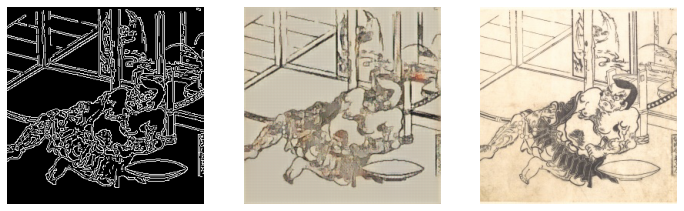

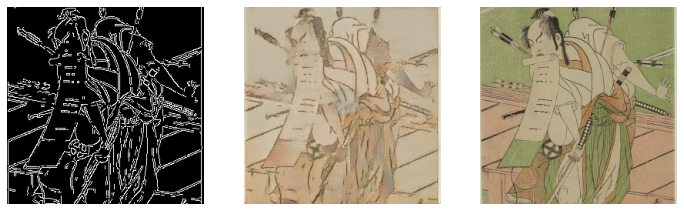

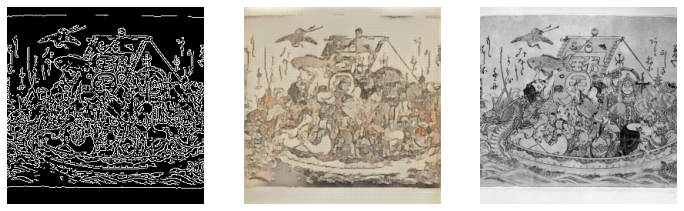

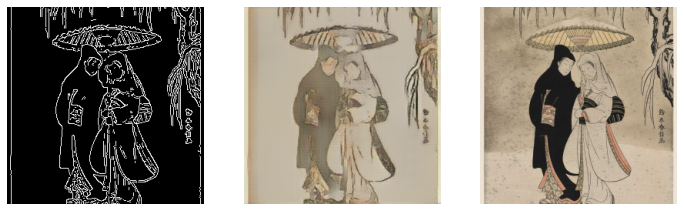

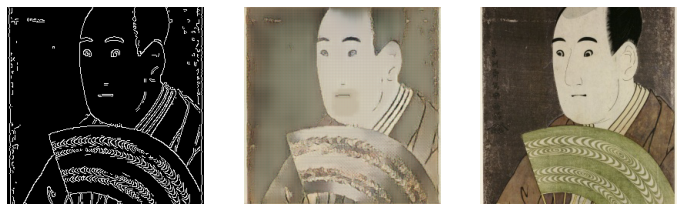

...

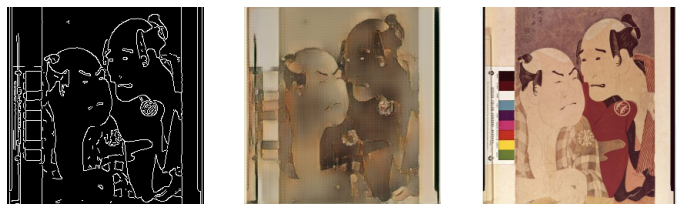

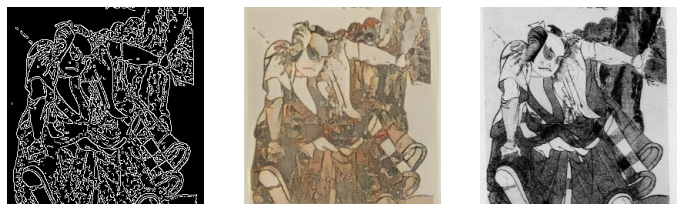

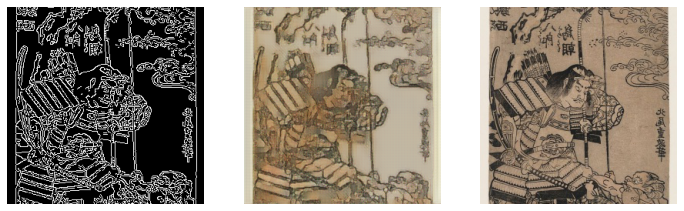

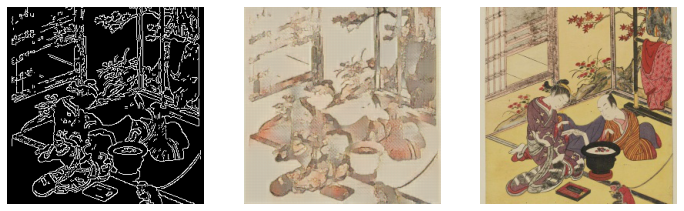

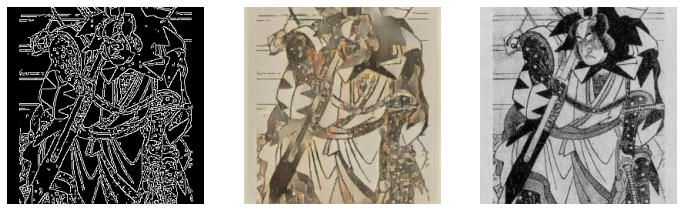

In [44]:
test_model(val_dataloader, gen)

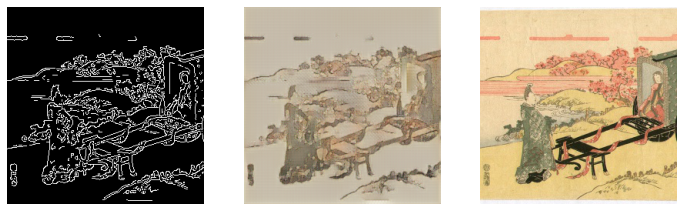

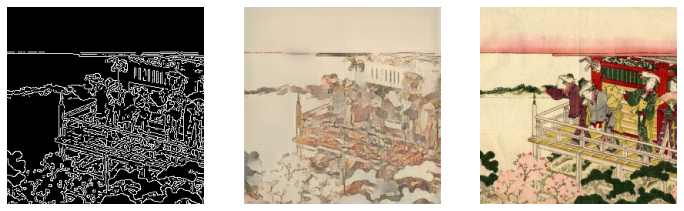

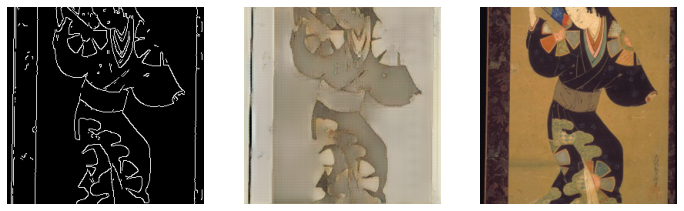

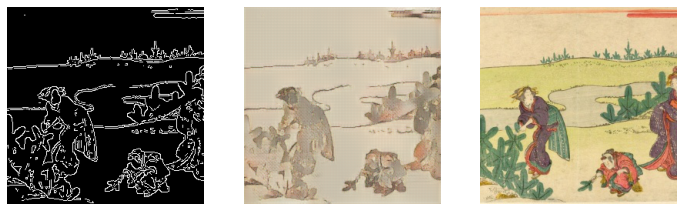

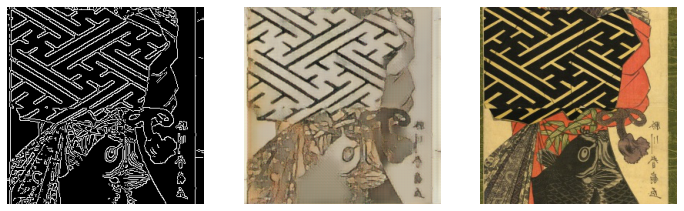

...

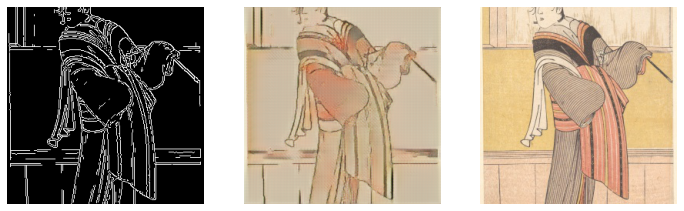

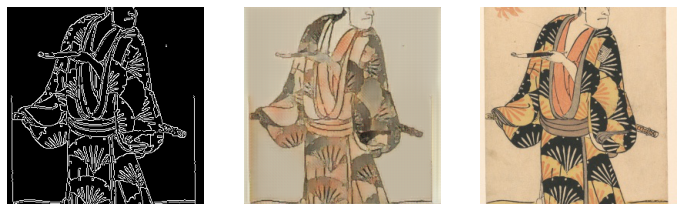

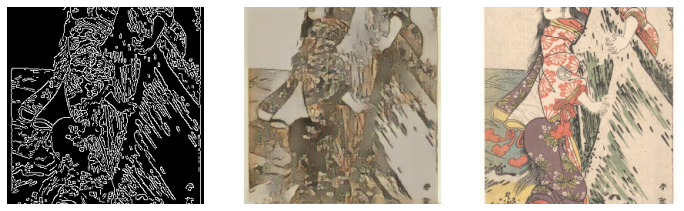

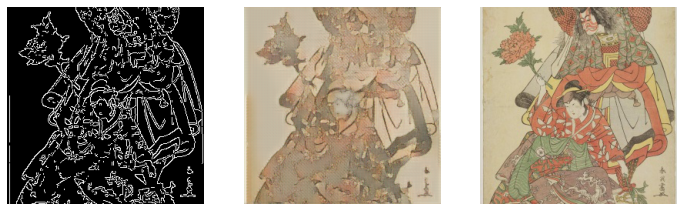

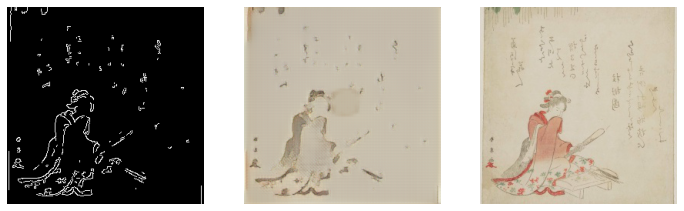

In [45]:
test_model(test_dataloader, gen)

### Test on other images

#### Test on colored images

Apply Canny Edge detector

Make model predictions



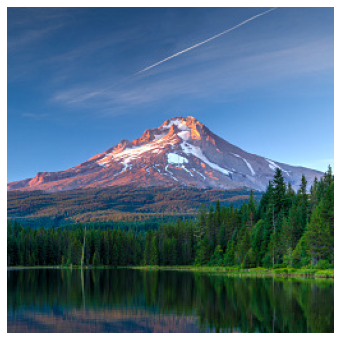

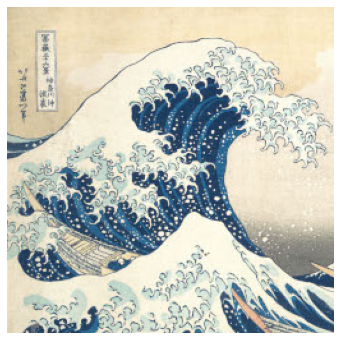

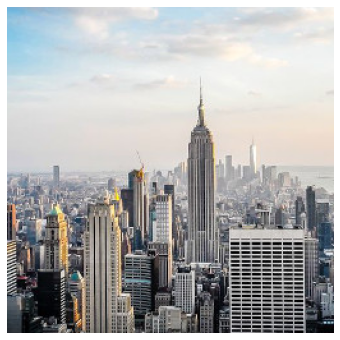

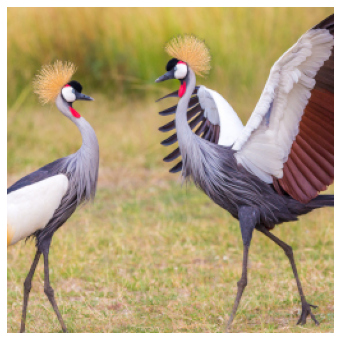

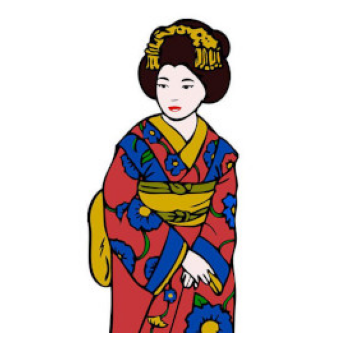

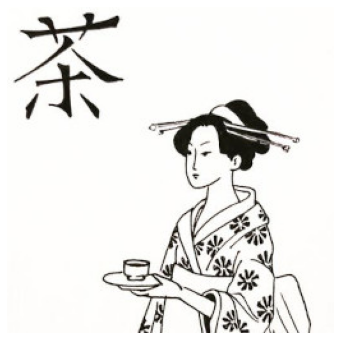

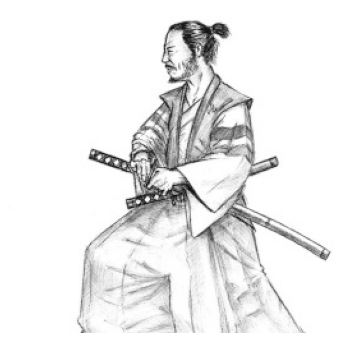

In [154]:
test_files = glob.glob('drive/MyDrive/DLIM/manual_test_img/*')

imgs = []
for path in test_files:
    img_pil = PIL.Image.open(path)
    img_np = np.array(img_pil).squeeze()
    imgs.append(img_np)

imgs = np.array(imgs)

for img_np in imgs:
    plt.figure(figsize=(8, 6))
    plt.imshow(img_np)
    plt.axis('off')
    plt.show()

In [155]:
inputs, targets = [], []

for img_np in imgs:
    # Convert input data to grayscale and uint8
    img_gray = 0.2989 * img_np[:, :, 0] + 0.5870 * img_np[:, :, 1] + 0.1140 * img_np[:, :, 2]
    img_gray = img_gray.astype(np.uint8)

    # Get edges using Canny edges detector
    edges = cv.Canny(img_gray, 150, 220)

    # Get input and target (in torch tensor)
    # Apply a threshold to keep only relevant/main information
    input = torch.from_numpy((edges > 125).astype(float))
    target = torch.from_numpy(img_np)

    # Get the transformation object (for normalization)
    transform = transforms.Compose([
                        transforms.ConvertImageDtype(torch.float),
                        transforms.Normalize(mean=0.5,
                                            std=0.5)
                    ])

    # Stack the input to get a 3 channel image (Still grayscale)
    input = torch.stack([input, input, input], dim=0)
    target = torch.permute(target, (2, 0, 1))

    # Apply transformation on input and on target image
    input = transform(input)
    target = transform(target)

    inputs.append(input)
    targets.append(target)

inputs = torch.stack(inputs)
targets = torch.stack(targets)
inputs.shape

torch.Size([7, 3, 256, 256])

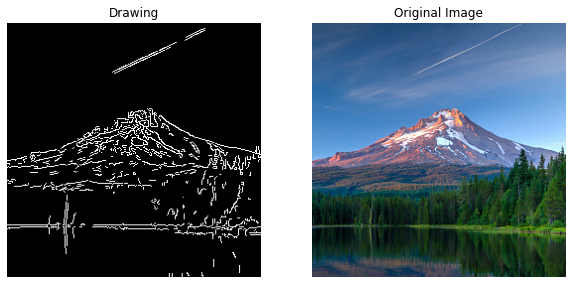

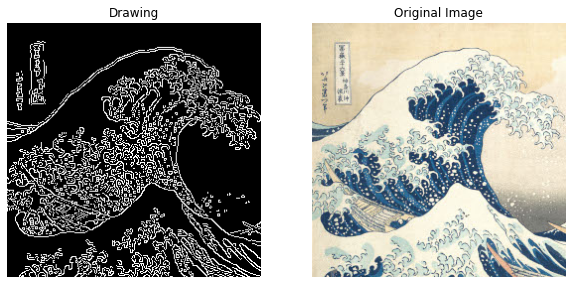

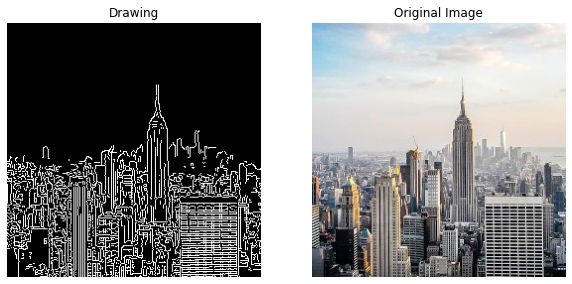

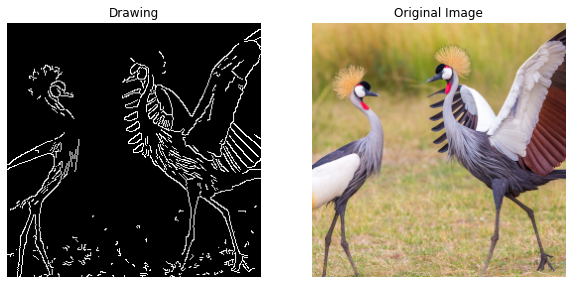

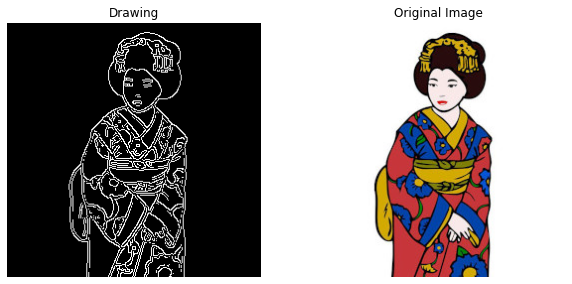

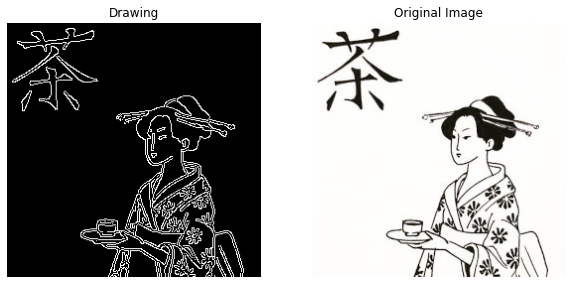

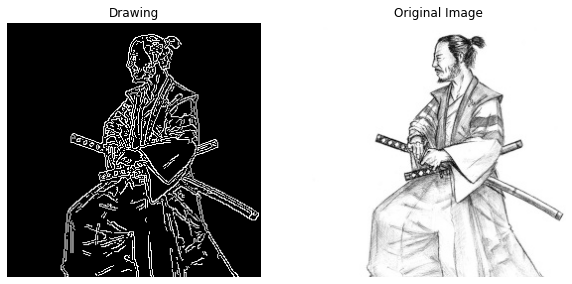

In [156]:
# Display input and target
# Remove normalization

for i in range(len(inputs)):
    input, target = inputs[i], targets[i]
    input_disp = input * 0.5 + 0.5
    target_disp = target * 0.5 + 0.5

    input_disp = torch.permute(input_disp, (1, 2, 0))
    target_disp = torch.permute(target_disp, (1, 2, 0))

    plt.figure(figsize=(10, 8))

    plt.subplot(1, 2, 1)
    plt.title('Drawing')
    plt.axis('off')
    plt.imshow(input_disp)

    plt.subplot(1, 2, 2)
    plt.title('Original Image')
    plt.axis('off')
    plt.imshow(target_disp)

    plt.show()

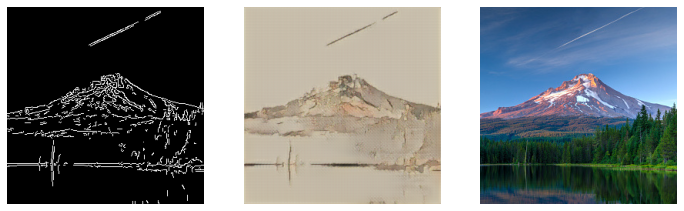

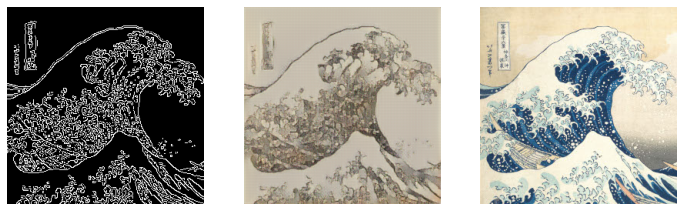

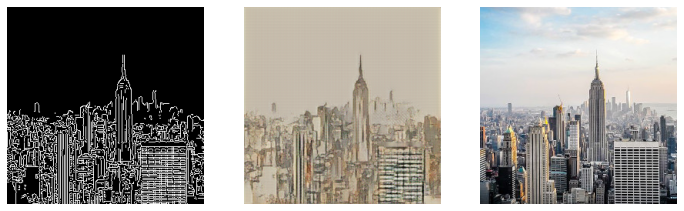

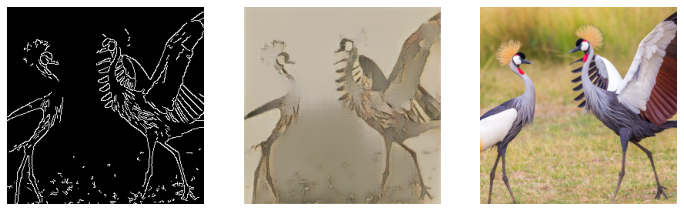

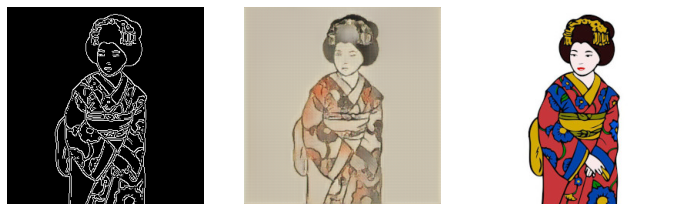

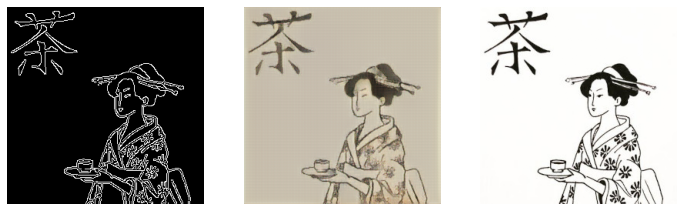

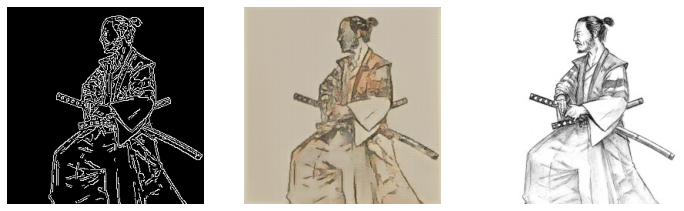

In [157]:
# Make predictions
gen.eval()

with torch.no_grad():
    inputs = inputs.to(device)
    pred = gen(inputs)

    # Remove normalization
    pred = pred * 0.5 + 0.5
    pred = torch.permute(pred, (0, 2, 3, 1))
    pred = pred.detach().cpu().numpy()

    inputs = inputs * 0.5 + 0.5
    inputs = torch.permute(inputs, (0, 2, 3, 1))
    inputs = inputs.detach().cpu().numpy()

    targets = targets * 0.5 + 0.5
    targets = torch.permute(targets, (0, 2, 3, 1))
    targets = targets.detach().cpu().numpy()

for idx, p in enumerate(pred):
    inpt = inputs[idx]
    tar = targets[idx]
    display_imgs(inpt, p, tar)